## Neural annotations

Finalising annotations of neural lineages

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/Neural.hvg5000_noCC.scvi_output.with_annotv2.22021124.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 24227 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

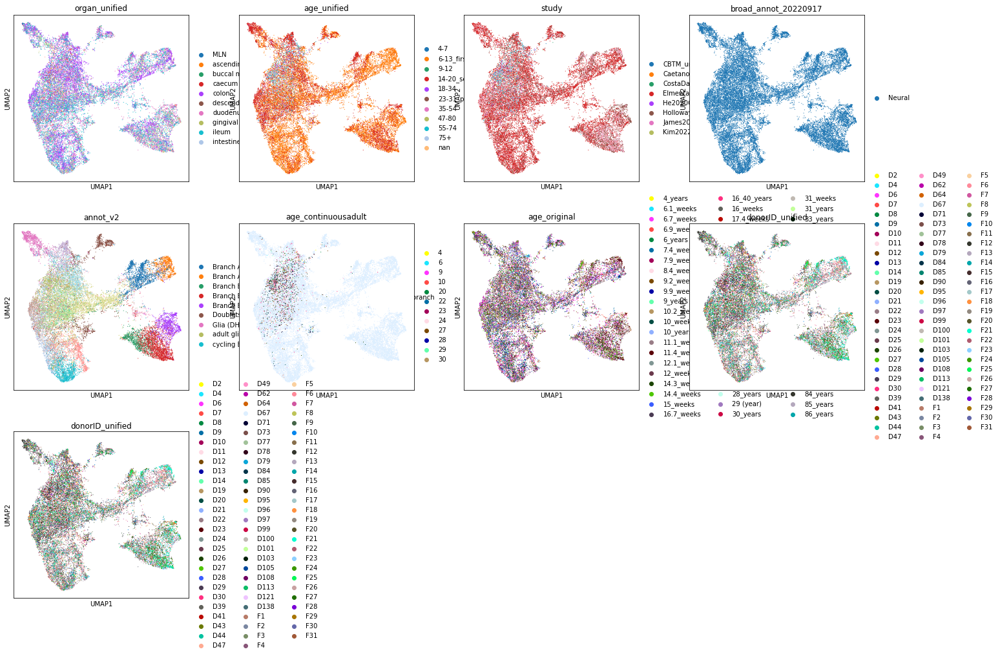

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousadult','age_original','donorID_unified','donorID_unified'],cmap='OrRd')

In [5]:
adata.X.max()

1910.0

In [6]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [7]:
adata.X.max()

8.311906

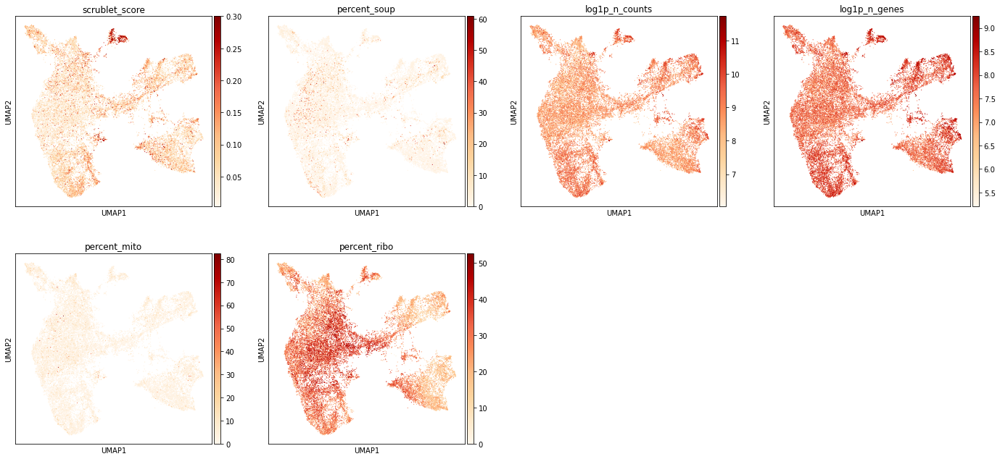

In [8]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

In [9]:
sc.tl.leiden(adata, resolution = 1, neighbors_key="neighbors_scvi")

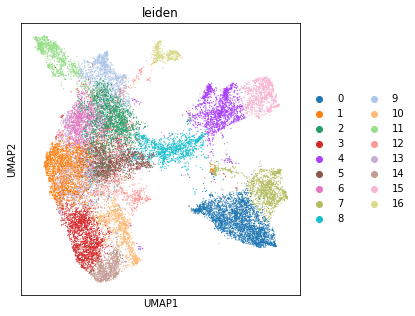

In [10]:
sc.pl.umap(adata,color=['leiden'])

In [15]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")

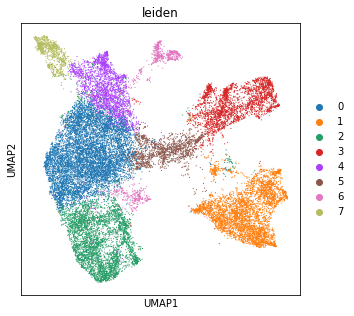

In [16]:
sc.pl.umap(adata,color=['leiden'])

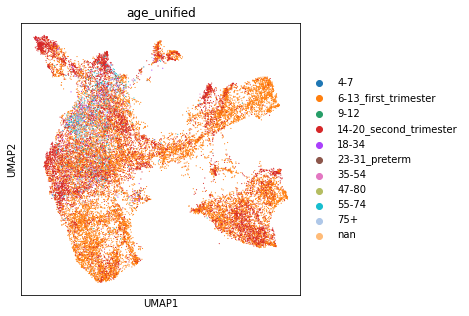

In [11]:
sc.pl.umap(adata,color='age_unified')

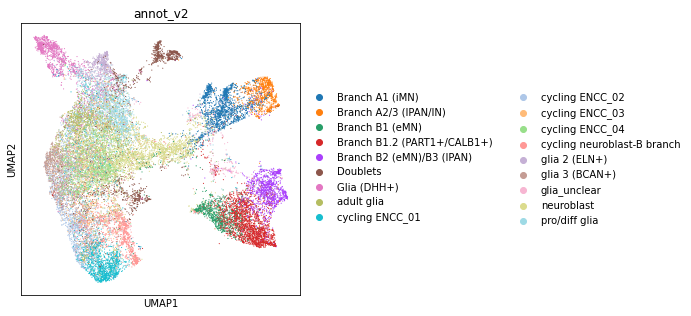

In [13]:
sc.pl.umap(adata,color='annot_v2')

In [12]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

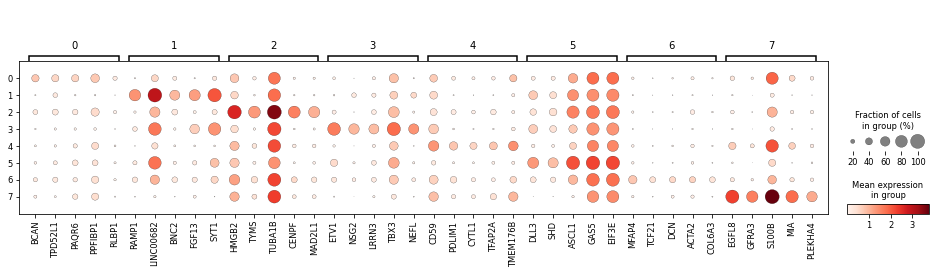

In [17]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

In [19]:
pd.crosstab(adata.obs.annot_v2,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7
annot_v2,,,,,,,,
Branch A1 (iMN),2,35,12,1444,9,100,3,1
Branch A2/3 (IPAN/IN),1,25,0,825,1,0,1,0
Branch B1 (eMN),19,731,8,4,0,86,5,0
Branch B1.2 (PART1+/CALB1+),11,1958,4,17,0,9,2,0
Branch B2 (eMN)/B3 (IPAN),10,1136,2,41,0,1,3,0
Doublets,250,74,149,38,168,40,871,5
Glia (DHH+),82,0,21,2,217,0,10,844
adult glia,1059,3,156,3,110,25,16,2
cycling ENCC_01,148,4,1149,1,53,0,3,8


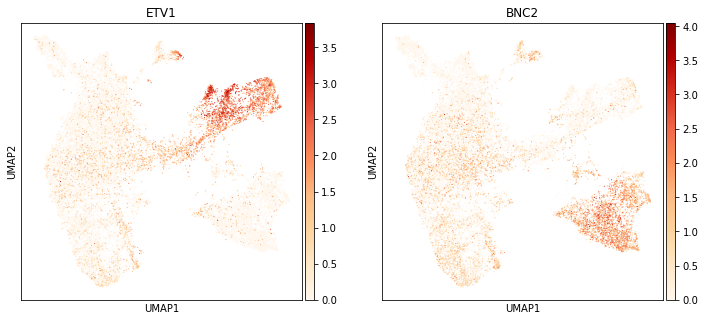

In [20]:
sc.pl.umap(adata,color=['ETV1','BNC2'],cmap='OrRd')

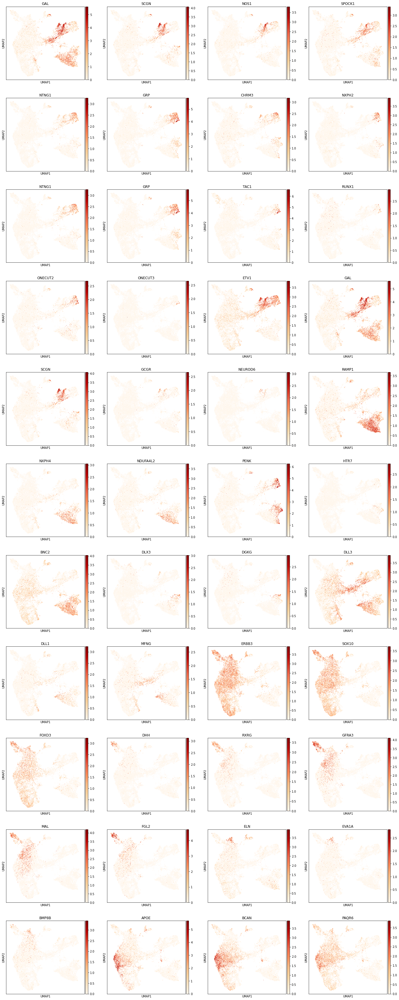

In [21]:
#marker genes from Elmentaite nature 2021 https://www.nature.com/articles/s41586-021-03852-1
sc.pl.umap(adata,color=['GAL','SCGN','NOS1','SPOCK1', #Branch A1 (iMN)
    'NTNG1','GRP','CHRM3','NXPH2', #Branch A2 (IPAN/IN)
    'NTNG1','GRP','TAC1','RUNX1','ONECUT2','ONECUT3', #Branch A3 (IPAN/IN)
    'ETV1','GAL','SCGN','GCGR','NEUROD6', #Branch A4 (IN)
    'RAMP1','NXPH4','NDUFA4L2', #Branch B1 (eMN)
    'PENK','HTR7', #Branch B2 (eMN)
    'BNC2','DLX3','DGKG', #Branch B3 (IPAN)
    'DLL3','DLL1','MFNG', #Neuroblast
    'ERBB3','SOX10','FOXD3', #ENCC/glial progenitor
    'DHH','RXRG','GFRA3','MAL','FGL2', #glial 1
    'ELN','EVA1A','BMP8B', #glial 2
    'APOE','BCAN','PAQR6', #glial 3
                        
                       
                       
                       ],cmap='OrRd')

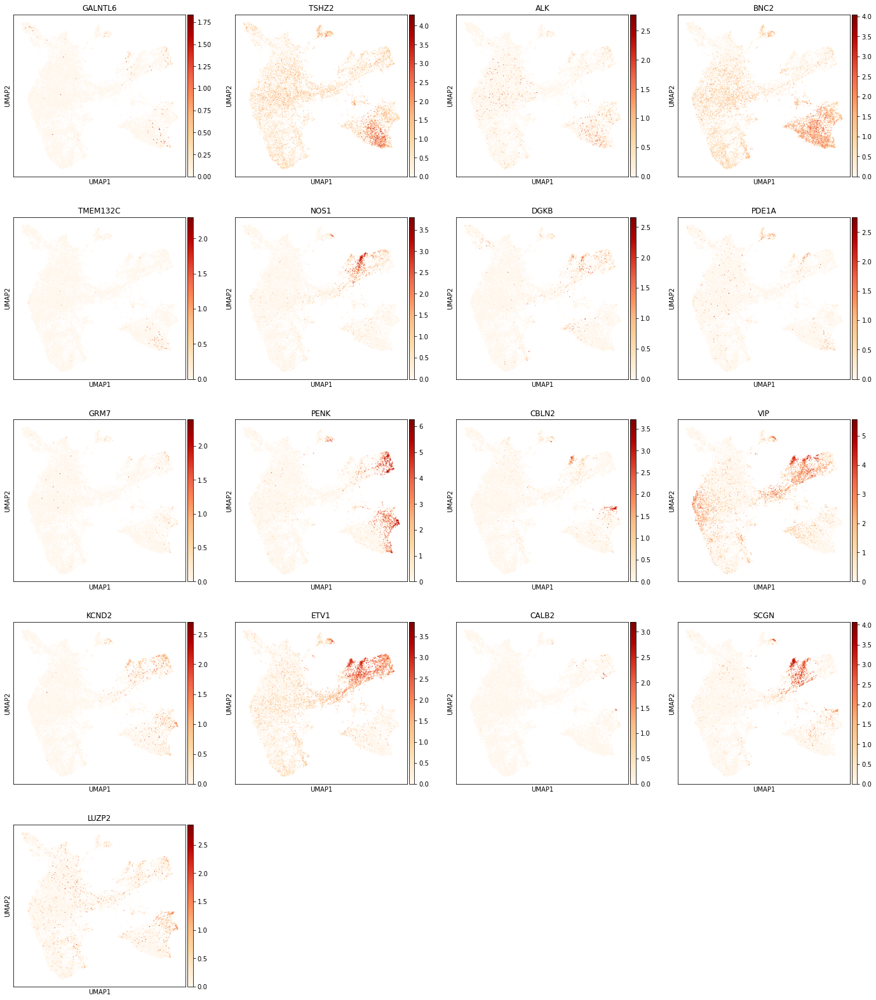

In [24]:
#marker genes from cell ENS paper https://www.cell.com/cell/pdf/S0092-8674(20)30994-6.pdf
sc.pl.umap(adata,color=['GALNTL6','TSHZ2','ALK','BNC2','TMEM132C', #PEMN excitary motor neuron (branch B equivalent)
                        'NOS1','DGKB','PDE1A', #PIMN inhibitory motor neuron (branch A1 equivalent + A2, A3, B4 IPAN/IN)
                        'GRM7','PENK', #PIN interneuron - branch A4 + A2, A3, B4 (IPAN+IN)
                       'CBLN2', #PSN sensory neuron - no equivalent in elmentaite 2021
                        'VIP','KCND2','ETV1','CALB2','SCGN','LUZP2' #PSVN - sencreto-motor/vasodilator neuron - ETV1 common with branch A4
                       
                       ],cmap='OrRd')

In [22]:
new_cluster_names = [
    'Glial','Branch_B1/2', #0,1
    'Enteric_neural_crest','Branch_A1/2/3', #2,3
    'Glial','Neuroblast', #4,5
    'Doublets','Glial' #6,7
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]

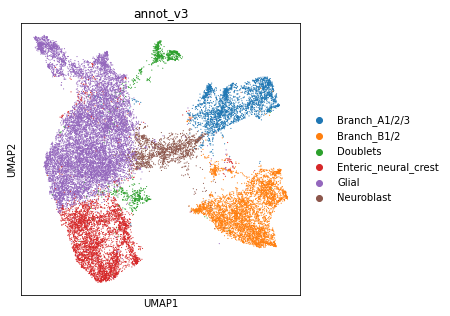

In [23]:
sc.pl.umap(adata,color='annot_v3')

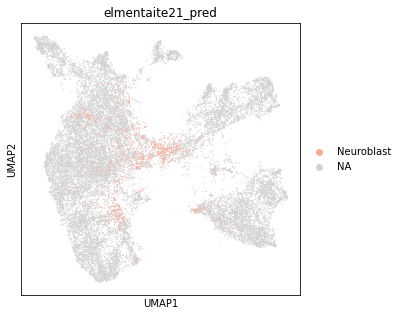

In [41]:
sc.pl.umap(adata,color='elmentaite21_pred',groups=['Neuroblast'])

In [25]:
glia = adata[adata.obs.annot_v3.isin([
 'Glial','Enteric_neural_crest','Neuroblast'])].copy()

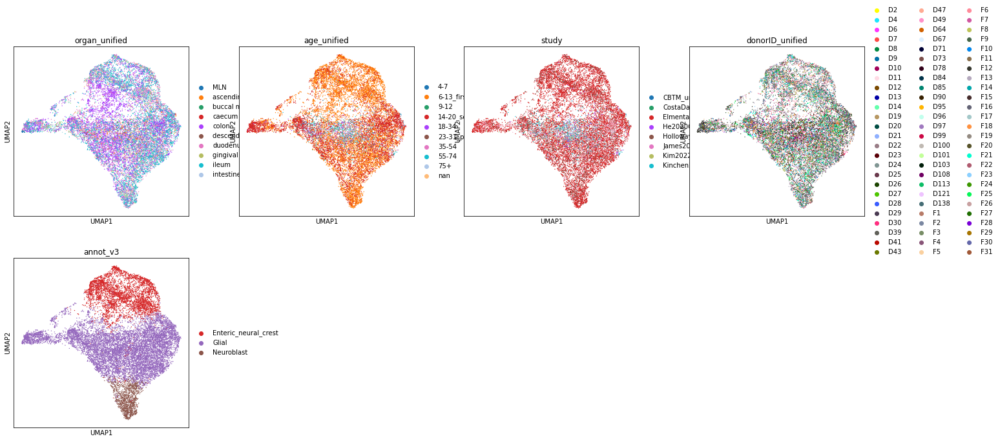

In [27]:
sc.pp.neighbors(
        glia,
            use_rep="X_scvi",
            n_pcs=glia.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(glia, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(glia, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

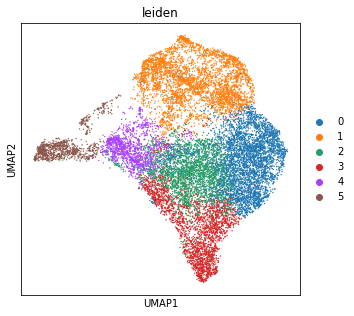

In [46]:
sc.tl.leiden(glia, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(glia, color=['leiden'])

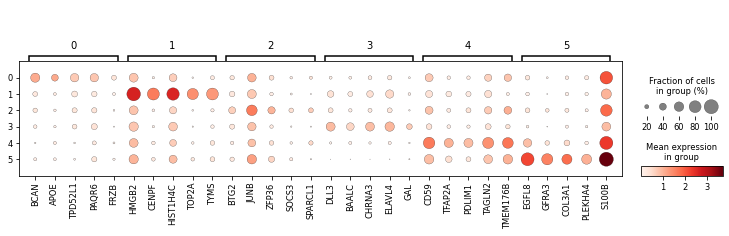

In [31]:
glia.raw = glia.copy()
mkst = calc_marker_stats(glia, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(glia, groupby='leiden', mks=mks)

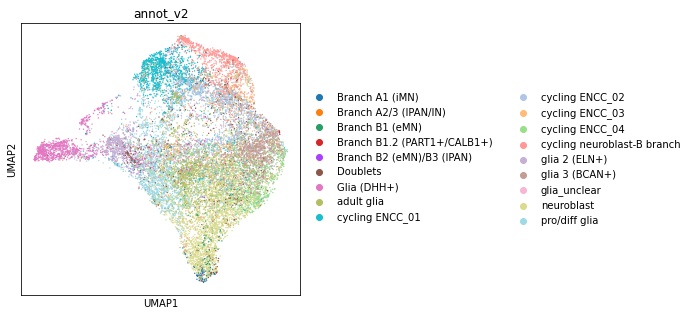

In [33]:
sc.pl.umap(glia,color='annot_v2')

In [36]:
list(glia.obs.elmentaite21_pred.unique())

['Adult Glia',
 'Stromal 1 (ADAMDEC1+)',
 'Transitional Stromal 3 (C3+)',
 'CLDN10+ cells',
 'Stromal 3 (C7+)',
 'ENCC/glia Progenitor',
 'Branch A1 (iMN)',
 'cycling neuroblast',
 'cycling ENCC/glia',
 'Neuroblast',
 'Branch B1 (eMN)',
 'Glia 1 (DHH+)',
 'Branch A2 (IPAN/IN)',
 'TA',
 'Branch A3 (IPAN/IN)',
 'Cycling B cell',
 'cDC2',
 'Glia 3 (BCAN+)',
 'Glia 2 (ELN+)',
 'Mesoderm 1 (HAND1+)',
 'Branch B2 (eMN)',
 'Branch A4 (IN)',
 'Stromal 2 (NPY+)',
 'IgA plasma cell',
 'Contractile pericyte (PLN+)',
 'BEST2+ Goblet cell',
 'Differentiating glia',
 'cycling stromal',
 'Mesoderm 2 (ZEB2+)',
 'Colonocyte',
 'ILC3',
 'Proximal progenitor',
 'RBC',
 'myofibroblast',
 'arterial capillary']

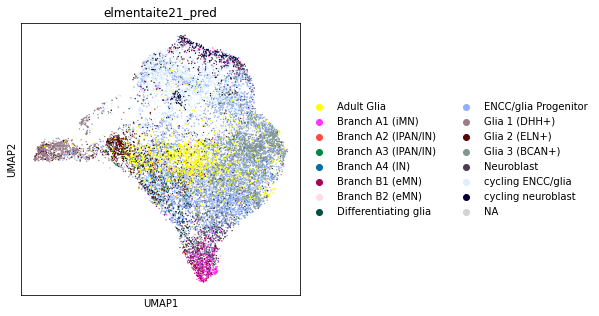

In [37]:
sc.pl.umap(glia,color='elmentaite21_pred',groups=['Adult Glia',
 'ENCC/glia Progenitor',
 'Branch A1 (iMN)',
 'cycling neuroblast',
 'cycling ENCC/glia',
 'Neuroblast',
 'Branch B1 (eMN)',
 'Glia 1 (DHH+)',
 'Branch A2 (IPAN/IN)',
 'Branch A3 (IPAN/IN)',
 'Glia 3 (BCAN+)',
 'Glia 2 (ELN+)',
 'Branch B2 (eMN)',
 'Branch A4 (IN)',
 'Differentiating glia'])

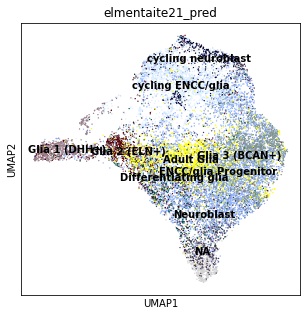

In [39]:
sc.pl.umap(glia,color='elmentaite21_pred',groups=['Adult Glia',
 'ENCC/glia Progenitor',
 
 'cycling neuroblast',
 'cycling ENCC/glia',
 'Neuroblast',
 'Glia 1 (DHH+)',
 'Glia 3 (BCAN+)',
 'Glia 2 (ELN+)',
 'Differentiating glia'],legend_loc='on data')

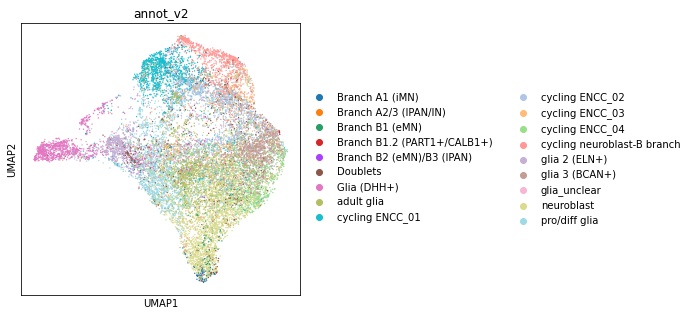

In [48]:
sc.pl.umap(glia,color='annot_v2')

In [47]:
pd.crosstab(glia.obs.elmentaite21_pred,glia.obs.leiden)

leiden,0,1,2,3,4,5
elmentaite21_pred,,,,,,
Adult Glia,509,48,733,58,286,10
BEST2+ Goblet cell,2,0,0,0,0,0
Branch A1 (iMN),4,78,20,330,5,0
Branch A2 (IPAN/IN),3,3,1,17,0,0
Branch A3 (IPAN/IN),0,0,2,0,1,0
Branch A4 (IN),0,2,1,3,0,0
Branch B1 (eMN),16,89,22,325,3,0
Branch B2 (eMN),1,1,2,0,0,0
CLDN10+ cells,1,0,0,0,0,0


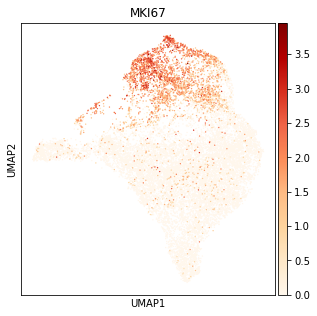

In [49]:
sc.pl.umap(glia,color='MKI67',cmap='OrRd')

In [60]:
new_cluster_names = [
    'Glial3_ENCC','Enteric_neural_crest_cycling', #0,1
    'Glial_ENCC','Neuroblast/BranchA1', #2,3
    'Glial2','Glial1', #4,5
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

glia.obs['annot_v3'] = [conv[x] for x in glia.obs['leiden']]

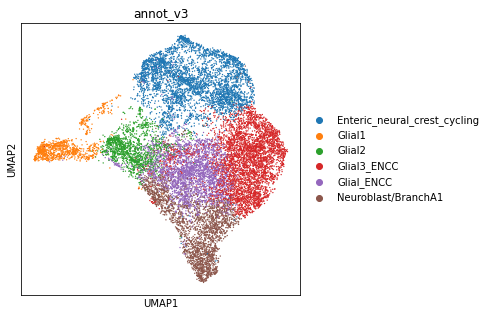

In [61]:
sc.pl.umap(glia,color='annot_v3')

In [62]:
glia1 = glia[glia.obs.annot_v3.isin([
 'Glial2','Glial1','Glial3_ENCC','Glial_ENCC'])].copy()

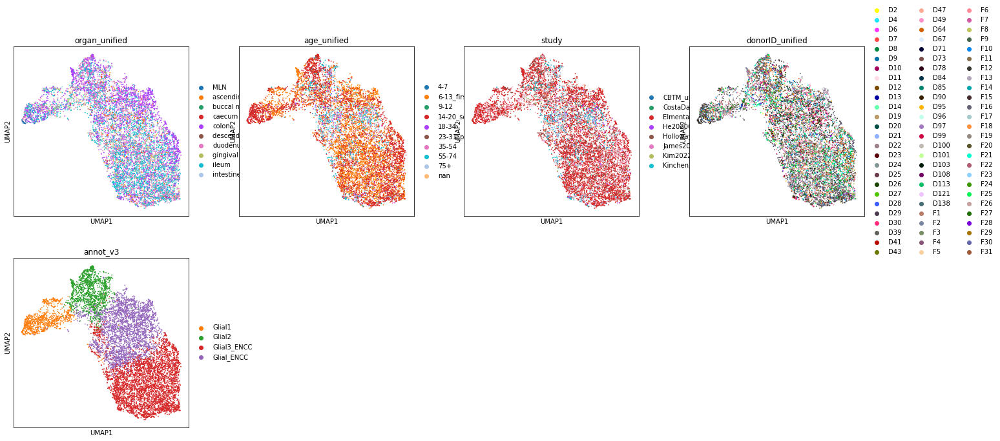

In [63]:
sc.pp.neighbors(
        glia1,
            use_rep="X_scvi",
            n_pcs=glia1.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(glia1, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(glia1, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

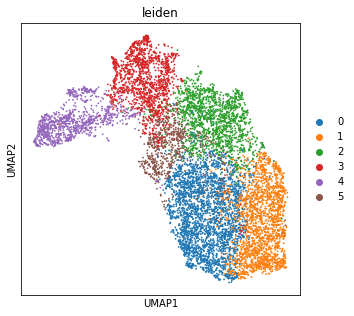

In [64]:
sc.tl.leiden(glia1, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(glia1, color=['leiden'])

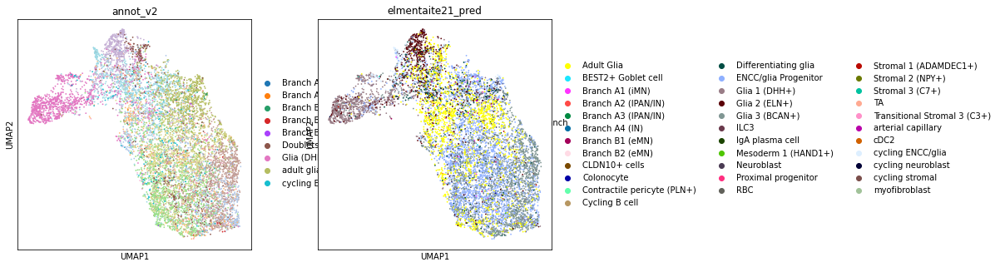

In [55]:
sc.pl.umap(glia1,color=['annot_v2','elmentaite21_pred'])

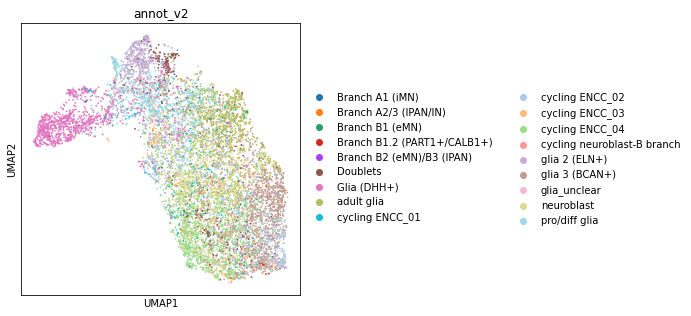

In [59]:
sc.pl.umap(glia1,color='annot_v2')

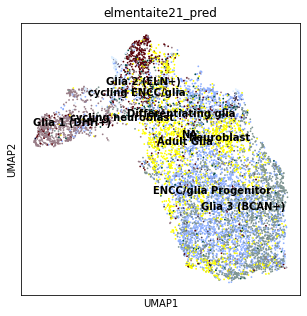

In [58]:
sc.pl.umap(glia1,color='elmentaite21_pred',groups=['Adult Glia',
 'ENCC/glia Progenitor',
 'cycling neuroblast',
 'cycling ENCC/glia',
 'Neuroblast',
 'Glia 1 (DHH+)',
 'Glia 3 (BCAN+)',
 'Glia 2 (ELN+)',
 'Differentiating glia'],legend_loc='on data')

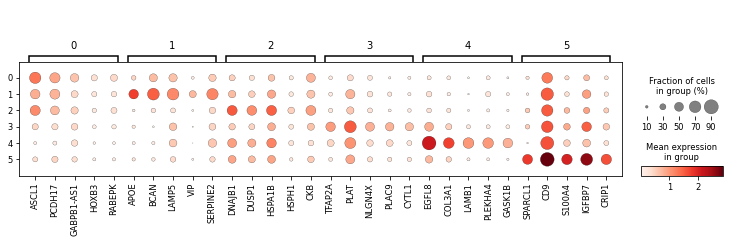

In [65]:
glia1.raw = glia1.copy()
mkst = calc_marker_stats(glia1, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(glia1, groupby='leiden', mks=mks)

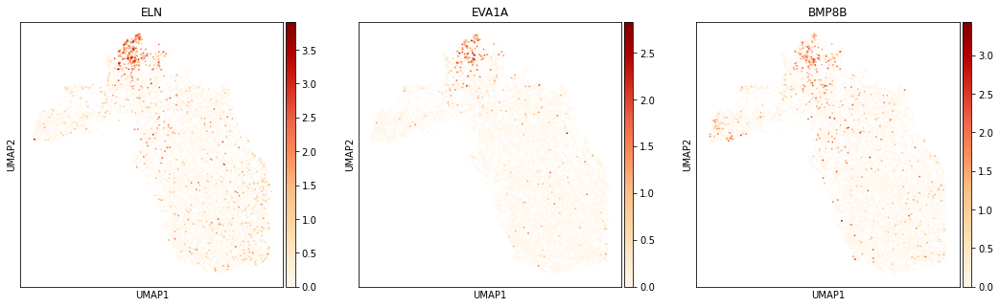

In [67]:
sc.pl.umap(glia1,color=['ELN','EVA1A','BMP8B'],cmap='OrRd')

In [68]:
pd.crosstab(glia1.obs.age_unified,glia1.obs.leiden)

leiden,0,1,2,3,4,5
age_unified,,,,,,
4-7,13,6,9,34,1,16
6-13_first_trimester,1729,867,872,439,405,159
9-12,1,0,0,4,1,5
14-20_second_trimester,655,1019,351,723,633,114
18-34,43,14,29,46,14,41
23-31_preterm,11,7,13,16,12,4
35-54,49,21,82,25,1,73
55-74,102,40,126,126,1,153
75+,109,55,75,64,0,95


In [69]:
new_cluster_names = [
    'Glial/Enteric_neural_crest','Glial_3', #0,1
    'Glial/Enteric_neural_crest','Glial_2', #2,3
    'Glial_1','Glial/Enteric_neural_crest', #4,5
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

glia1.obs['annot_v3'] = [conv[x] for x in glia1.obs['leiden']]

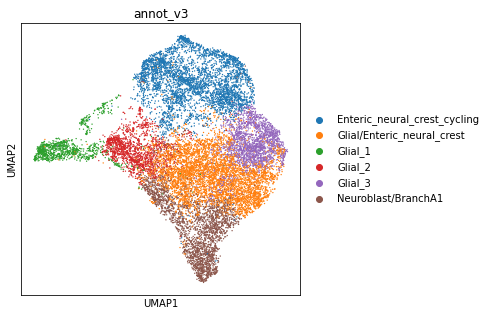

In [70]:
ON = {O:N for O,N in zip(glia1.obs_names,glia1.obs["annot_v3"])}
glia.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(glia.obs_names, glia.obs["annot_v3"])]
sc.pl.umap(glia,color='annot_v3')

In [71]:
nb = glia[glia.obs.annot_v3.isin([
 'Neuroblast/BranchA1'])].copy()

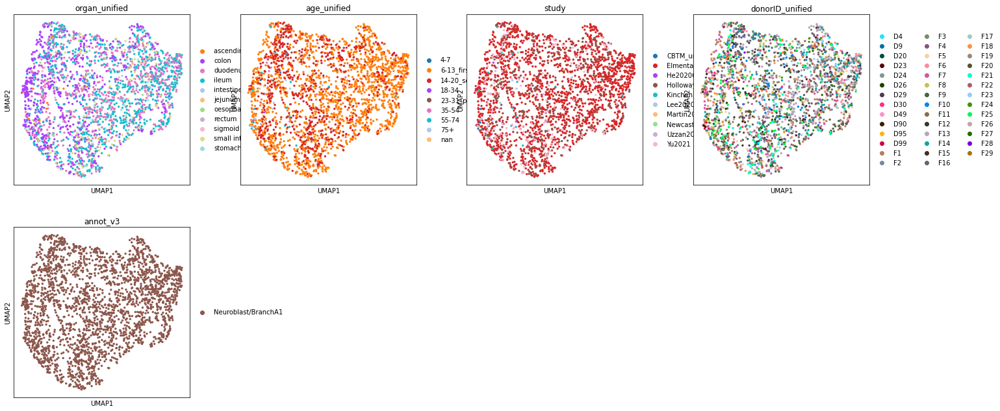

In [72]:
sc.pp.neighbors(
        nb,
            use_rep="X_scvi",
            n_pcs=nb.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(nb, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(nb, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

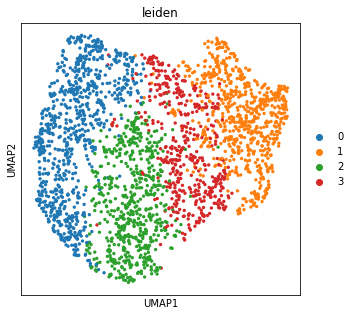

In [75]:
sc.tl.leiden(nb, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(nb, color=['leiden'])

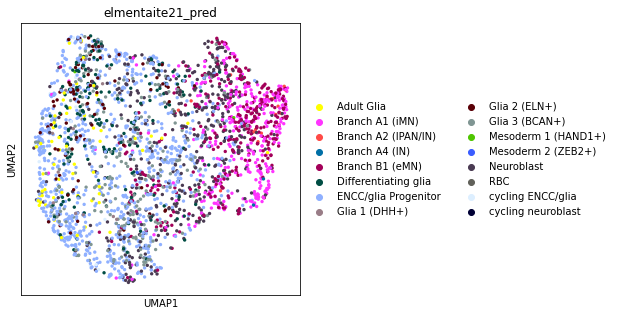

In [76]:
sc.pl.umap(nb,color='elmentaite21_pred')

In [77]:
new_cluster_names = [
    'Neuroblast','Branch_A1', #0,1
    'Neuroblast','Neuroblast', #2,3
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

nb.obs['annot_v3'] = [conv[x] for x in nb.obs['leiden']]

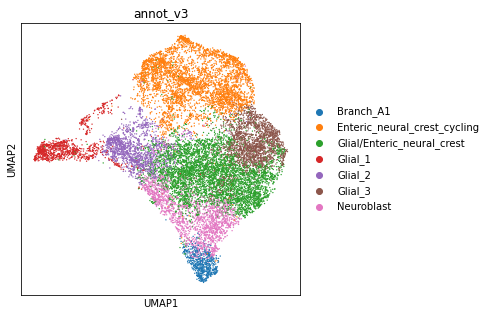

In [78]:
ON = {O:N for O,N in zip(nb.obs_names,nb.obs["annot_v3"])}
glia.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(glia.obs_names, glia.obs["annot_v3"])]
sc.pl.umap(glia,color='annot_v3')

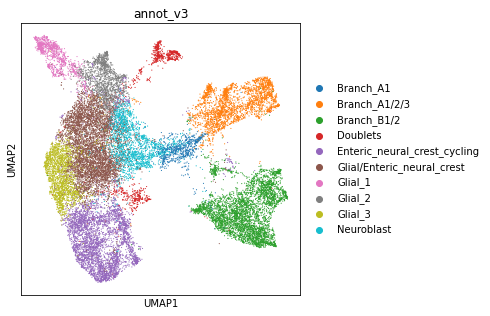

In [80]:
ON = {O:N for O,N in zip(glia.obs_names,glia.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [81]:
brancha = adata[adata.obs['annot_v3'].isin(['Branch_A1','Branch_A1/2/3'])]

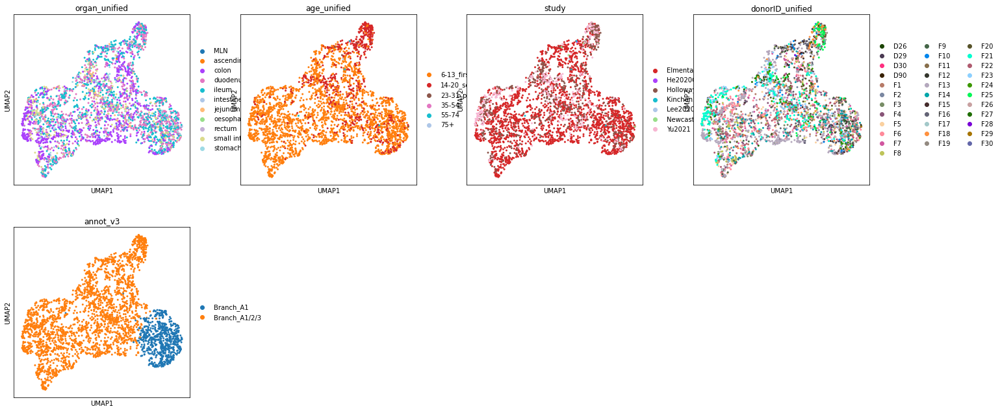

In [82]:
sc.pp.neighbors(
        brancha,
            use_rep="X_scvi",
            n_pcs=brancha.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(brancha, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(brancha, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

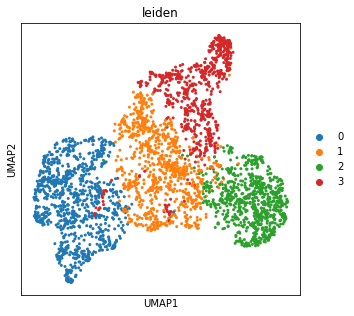

In [85]:
sc.tl.leiden(brancha, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(brancha, color=['leiden'])

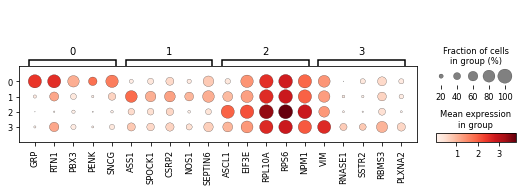

In [86]:
brancha.raw = brancha.copy()
mkst = calc_marker_stats(brancha, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(brancha, groupby='leiden', mks=mks)

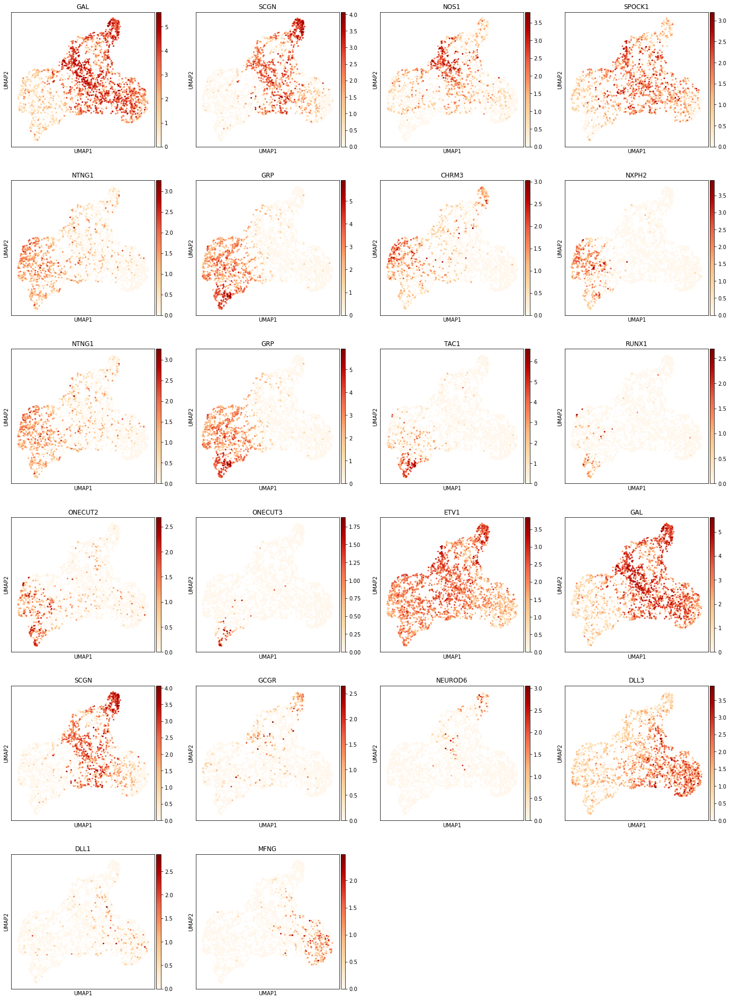

In [89]:
#marker genes from Elmentaite nature 2021 https://www.nature.com/articles/s41586-021-03852-1
sc.pl.umap(brancha,color=['GAL','SCGN','NOS1','SPOCK1', #Branch A1 (iMN)
    'NTNG1','GRP','CHRM3','NXPH2', #Branch A2 (IPAN/IN)
    'NTNG1','GRP','TAC1','RUNX1','ONECUT2','ONECUT3', #Branch A3 (IPAN/IN)
    'ETV1','GAL','SCGN','GCGR','NEUROD6', #Branch A4 (IN)
        'DLL3','DLL1','MFNG', #Neuroblast
                       
                       
                       ],cmap='OrRd')

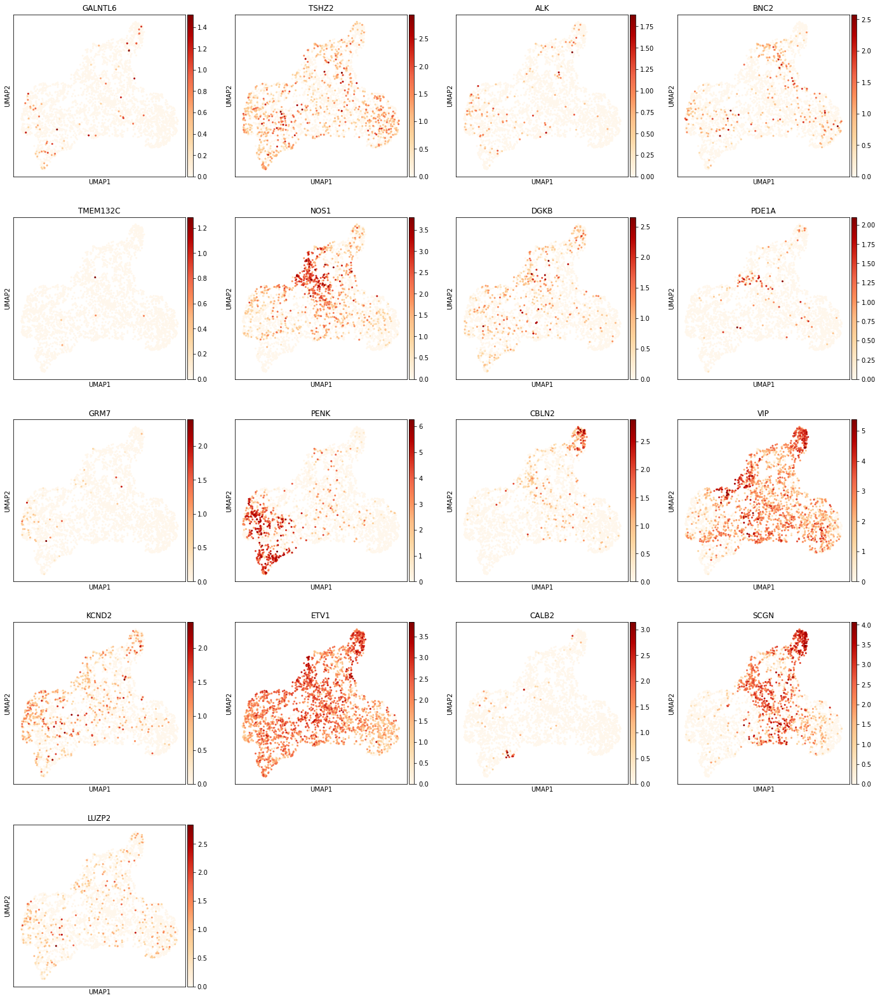

In [96]:
#marker genes from cell ENS paper https://www.cell.com/cell/pdf/S0092-8674(20)30994-6.pdf
sc.pl.umap(brancha,color=['GALNTL6','TSHZ2','ALK','BNC2','TMEM132C', #PEMN excitary motor neuron (branch B equivalent)
                        'NOS1','DGKB','PDE1A', #PIMN inhibitory motor neuron (branch A1 equivalent + A2, A3, B4 IPAN/IN)
                        'GRM7','PENK', #PIN interneuron - branch A4 + A2, A3, B4 (IPAN+IN)
                       'CBLN2', #PSN sensory neuron - no equivalent in elmentaite 2021
                        'VIP','KCND2','ETV1','CALB2','SCGN','LUZP2' #PSVN - sencreto-motor/vasodilator neuron - ETV1 common with branch A4
                       
                       ],cmap='OrRd')

In [90]:
new_cluster_names = [
    'Branch_A_primary_afferent_neuron','Branch_A_inhibtory_motor_neuron', #0,1
    'Neuroblast','Branch_A_interneuron', #2,3
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

brancha.obs['annot_v3'] = [conv[x] for x in brancha.obs['leiden']]

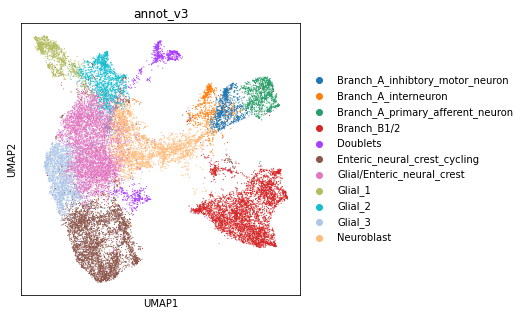

In [91]:
ON = {O:N for O,N in zip(brancha.obs_names,brancha.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [92]:
branchb = adata[adata.obs['annot_v3'].isin(['Branch_B1/2'])]

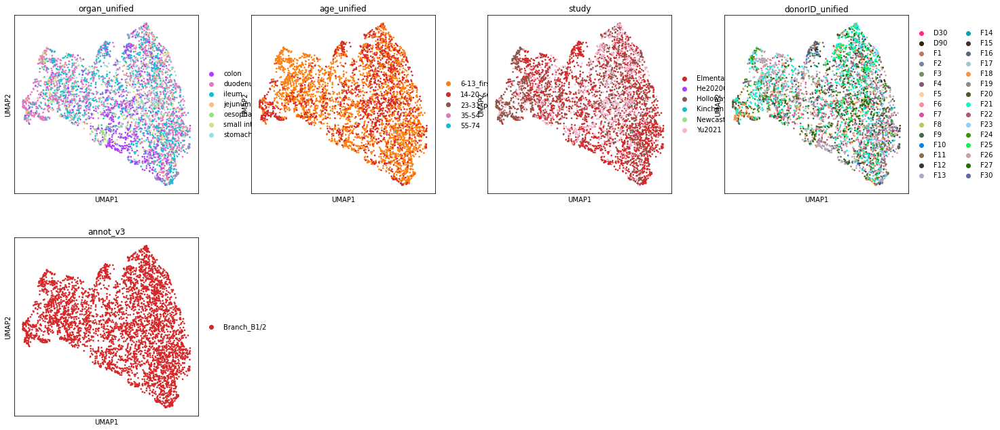

In [93]:
sc.pp.neighbors(
        branchb,
            use_rep="X_scvi",
            n_pcs=branchb.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(branchb, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(branchb, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

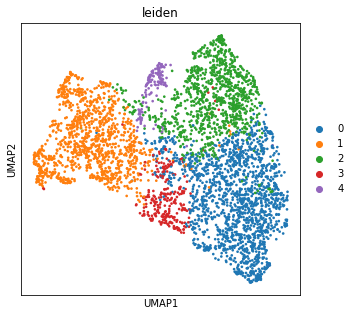

In [106]:
sc.tl.leiden(branchb, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(branchb, color=['leiden'])

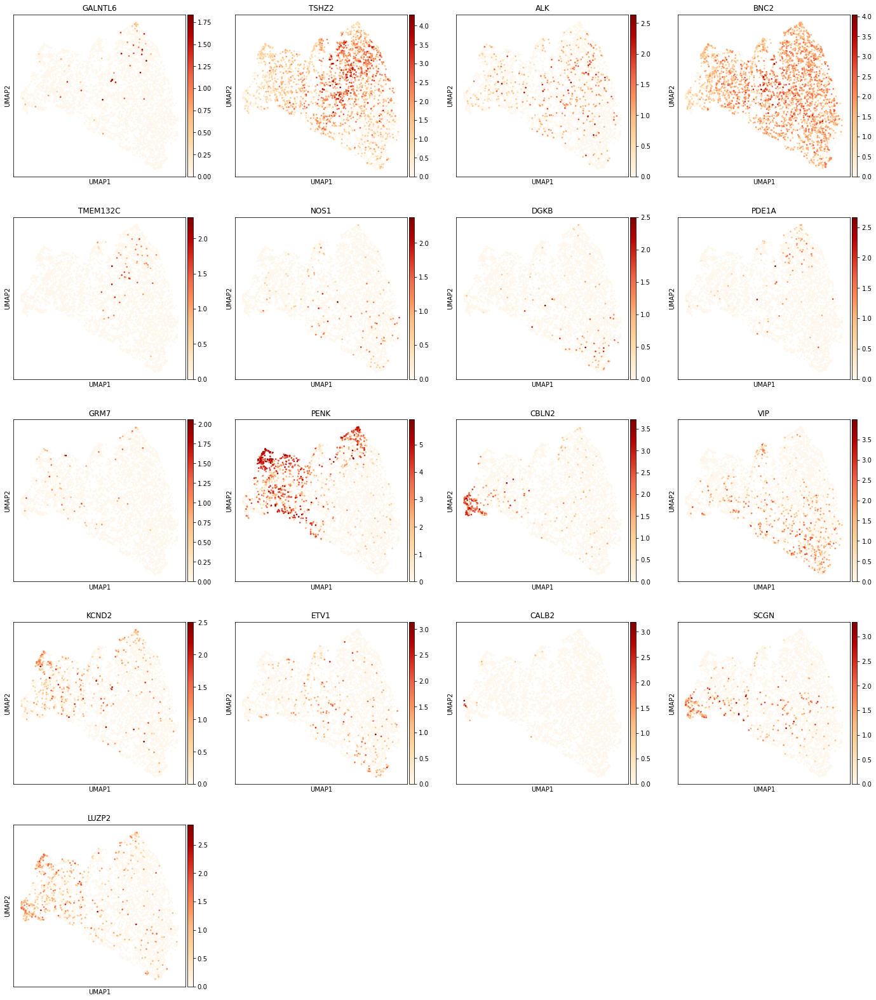

In [97]:
#marker genes from cell ENS paper https://www.cell.com/cell/pdf/S0092-8674(20)30994-6.pdf
sc.pl.umap(branchb,color=['GALNTL6','TSHZ2','ALK','BNC2','TMEM132C', #PEMN excitary motor neuron (branch B equivalent)
                        'NOS1','DGKB','PDE1A', #PIMN inhibitory motor neuron (branch A1 equivalent + A2, A3, B4 IPAN/IN)
                        'GRM7','PENK', #PIN interneuron - branch A4 + A2, A3, B4 (IPAN+IN)
                       'CBLN2', #PSN sensory neuron - no equivalent in elmentaite 2021
                        'VIP','KCND2','ETV1','CALB2','SCGN','LUZP2' #PSVN - sencreto-motor/vasodilator neuron - ETV1 common with branch A4
                       
                       ],cmap='OrRd')

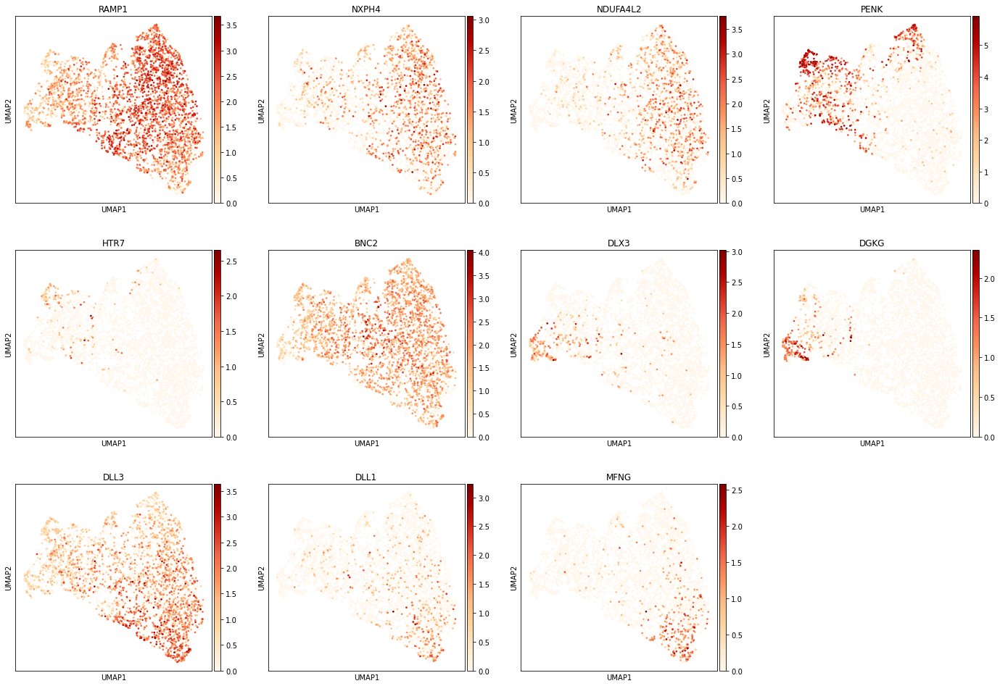

In [99]:
#marker genes from Elmentaite nature 2021 https://www.nature.com/articles/s41586-021-03852-1
sc.pl.umap(branchb,color=[
    'RAMP1','NXPH4','NDUFA4L2', #Branch B1 (eMN)
    'PENK','HTR7', #Branch B2 (eMN)
    'BNC2','DLX3','DGKG', #Branch B3 (IPAN)
    'DLL3','DLL1','MFNG', #Neuroblast
                        
                       
                       
                       ],cmap='OrRd')

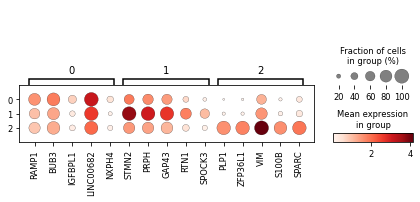

In [101]:
branchb.raw = branchb.copy()
mkst = calc_marker_stats(branchb, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(branchb, groupby='leiden', mks=mks)

In [107]:
new_cluster_names = [
    'Branch_B_excitatory_motor_neuron','Branch_B_primary_afferent_neuron', #0,1
    'Branch_B_excitatory_motor_neuron','Branch_B_excitatory_motor_neuron',#2,3
    'Doublets' #4
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

branchb.obs['annot_v3'] = [conv[x] for x in branchb.obs['leiden']]

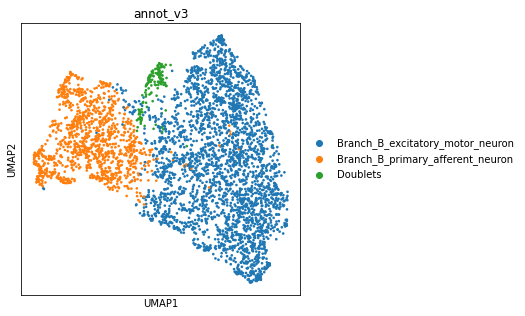

In [108]:
sc.pl.umap(branchb,color='annot_v3')

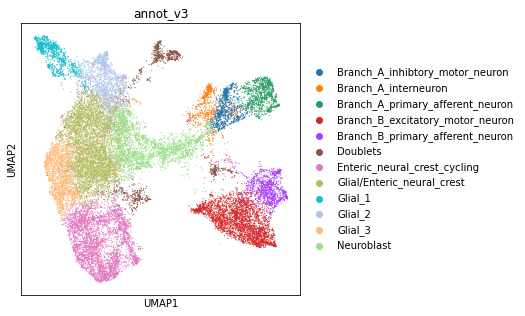

In [109]:
ON = {O:N for O,N in zip(branchb.obs_names,branchb.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [110]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Neural.hvg5000_noCC.scvi_output.annotv3.20230105.h5ad')

In [111]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [112]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Neural_annot_v3.csv')

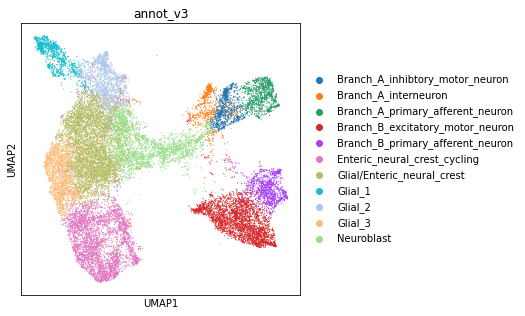

In [113]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [114]:
adata_nodoublets.X.max()

8.311906

In [115]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [116]:
adata_nodoublets.X.max()

1910.0

In [117]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Neural.raw.annotv3.nodoublets.20230105.h5ad')

## Plot marker genes and UMAPs

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Neural.hvg5000_noCC.scvi_output.annotv3.20230105.h5ad')

In [3]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

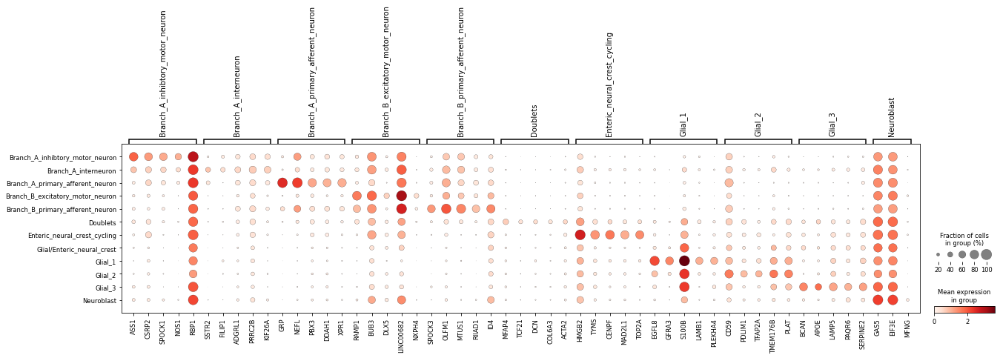

In [4]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3', mks=mks)

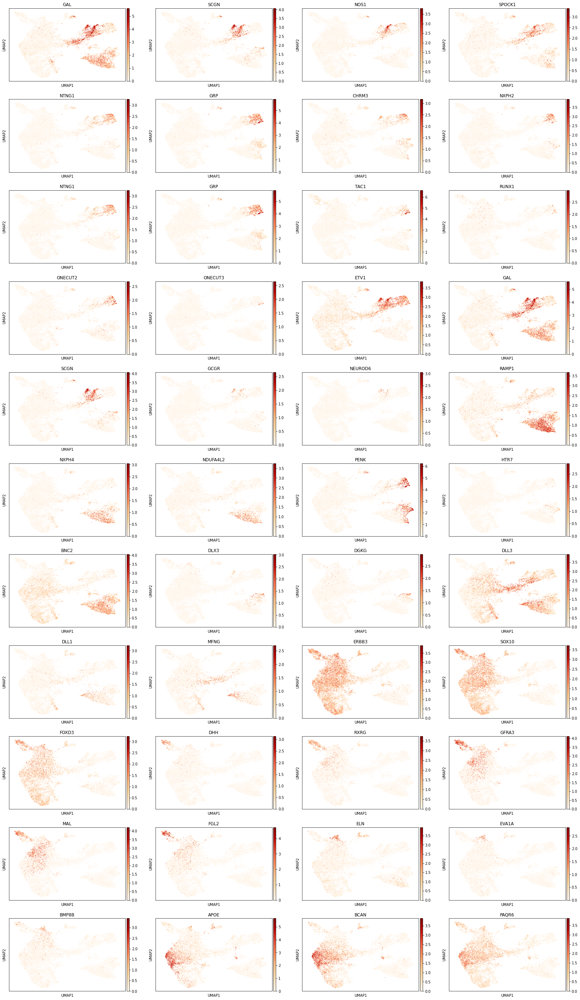

In [5]:
#marker genes from Elmentaite nature 2021 https://www.nature.com/articles/s41586-021-03852-1
sc.pl.umap(adata,color=['GAL','SCGN','NOS1','SPOCK1', #Branch A1 (iMN)
    'NTNG1','GRP','CHRM3','NXPH2', #Branch A2 (IPAN/IN)
    'NTNG1','GRP','TAC1','RUNX1','ONECUT2','ONECUT3', #Branch A3 (IPAN/IN)
    'ETV1','GAL','SCGN','GCGR','NEUROD6', #Branch A4 (IN)
    'RAMP1','NXPH4','NDUFA4L2', #Branch B1 (eMN)
    'PENK','HTR7', #Branch B2 (eMN)
    'BNC2','DLX3','DGKG', #Branch B3 (IPAN)
    'DLL3','DLL1','MFNG', #Neuroblast
    'ERBB3','SOX10','FOXD3', #ENCC/glial progenitor
    'DHH','RXRG','GFRA3','MAL','FGL2', #glial 1
    'ELN','EVA1A','BMP8B', #glial 2
    'APOE','BCAN','PAQR6', #glial 3
                        
                       
                       
                       ],cmap='OrRd')

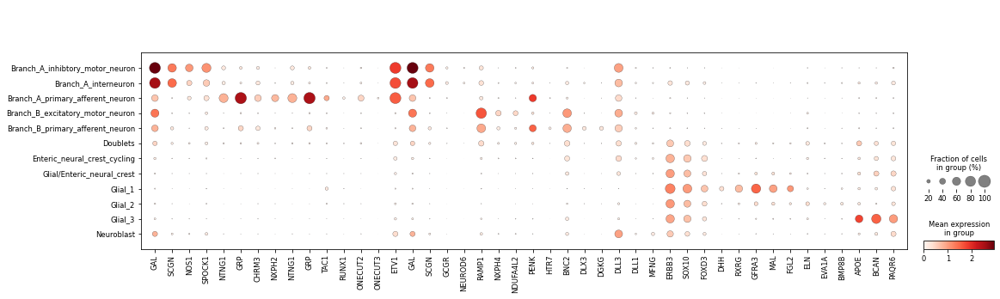

In [6]:
sc.pl.dotplot(adata,var_names=['GAL','SCGN','NOS1','SPOCK1', #Branch A1 (iMN)
    'NTNG1','GRP','CHRM3','NXPH2', #Branch A2 (IPAN/IN)
    'NTNG1','GRP','TAC1','RUNX1','ONECUT2','ONECUT3', #Branch A3 (IPAN/IN)
    'ETV1','GAL','SCGN','GCGR','NEUROD6', #Branch A4 (IN)
    'RAMP1','NXPH4','NDUFA4L2', #Branch B1 (eMN)
    'PENK','HTR7', #Branch B2 (eMN)
    'BNC2','DLX3','DGKG', #Branch B3 (IPAN)
    'DLL3','DLL1','MFNG', #Neuroblast
    'ERBB3','SOX10','FOXD3', #ENCC/glial progenitor
    'DHH','RXRG','GFRA3','MAL','FGL2', #glial 1
    'ELN','EVA1A','BMP8B', #glial 2
    'APOE','BCAN','PAQR6', #glial 3
                           ],groupby='annot_v3')

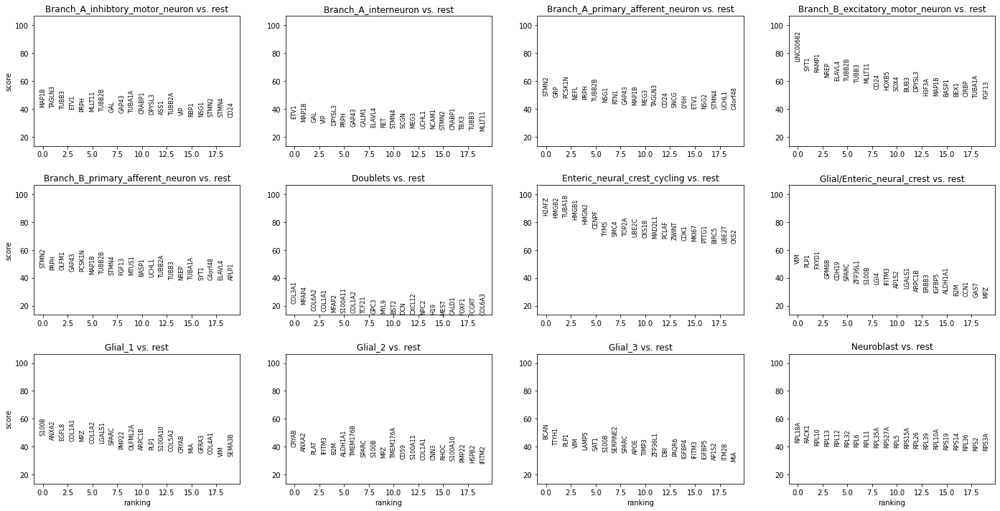

In [8]:
adata.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(adata,groupby='annot_v3',method='wilcoxon')
sc.pl.rank_genes_groups(adata)

In [12]:
marker_genes_dict = {'General_branch':['CHRNA3','ELAVL4','ELAVL3','GAP43'],
                    'Branch_A_IMN':['NOS1','SPOCK1','SCGN'],
                     'Branch_A_interneuron':['SSTR2','FILIP1'],
                     'Branch_A_PAN':['NTNG1','GRP','NEFL','TAC1'],
                     'Branch_B_EMN':['RAMP1','NXPH4','NDUFA4L2','DLX5'],
                     'Branch_B_PAN':['DLX3','DGKG','SPOCK3','OLFM1'],
                     'General_glia':['NPM1','PLP1','SOX10','ERBB3'],
                     'Enteric_neural_crest_cycling':['MKI67','TOP2A','HMGB2','TYMS','CENPF','MAD2L1'],
                     'Glial_1':['LAMB1','RXRG','GFRA3','MAL','FGL2'],
                     'Glial_2':['PDLIM1','TFAP2A','EVA1A','BMP8B'],
                     'Glial_3':['APOE','BCAN','PAQR6','LAMP5'],
                     'Neuroblast':['MFNG']
                    
                    
                    }

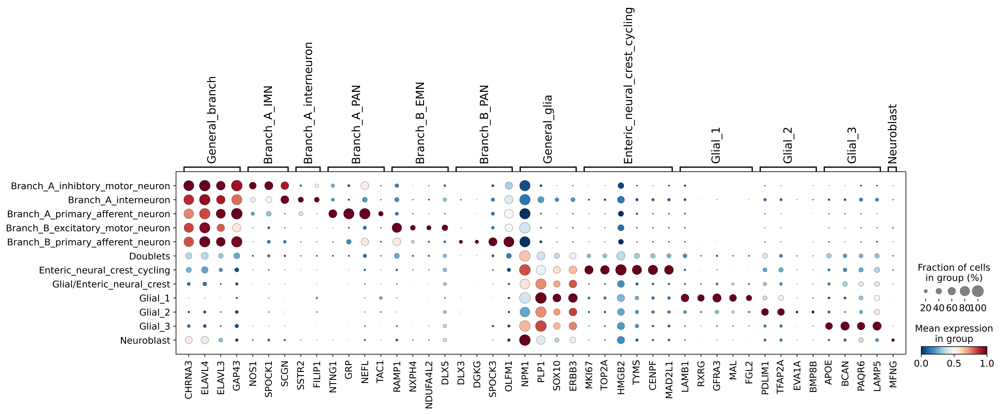

In [13]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi=300,dpi_save=600)
sc.pl.dotplot(adata, var_names=marker_genes_dict, groupby='annot_v3', color_map='RdBu_r', standard_scale='var',save='neural_markers.pdf')

In [14]:
plt.rcParams['figure.figsize'] = [5,5]

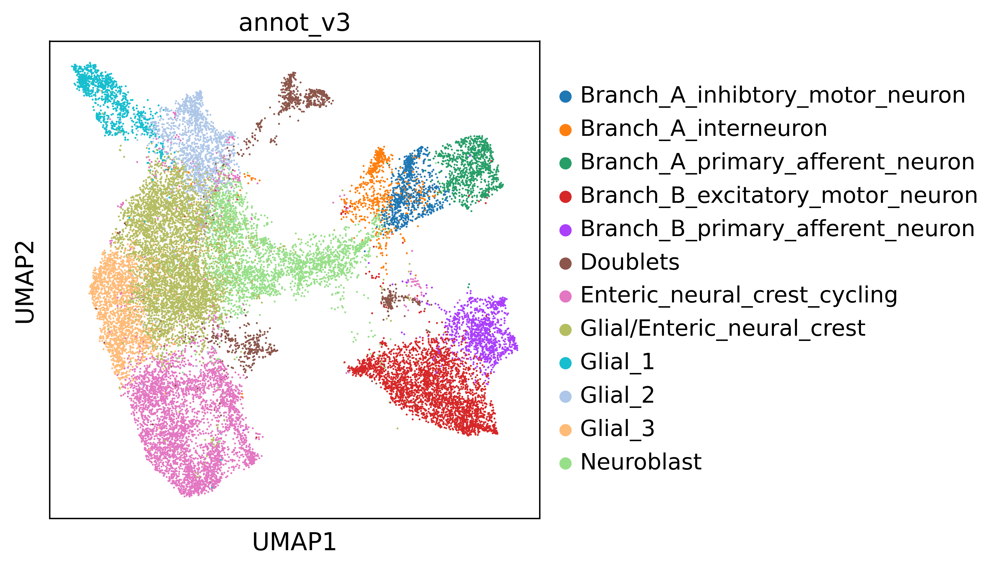

In [15]:
sc.pl.umap(adata,color='annot_v3')

In [16]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()

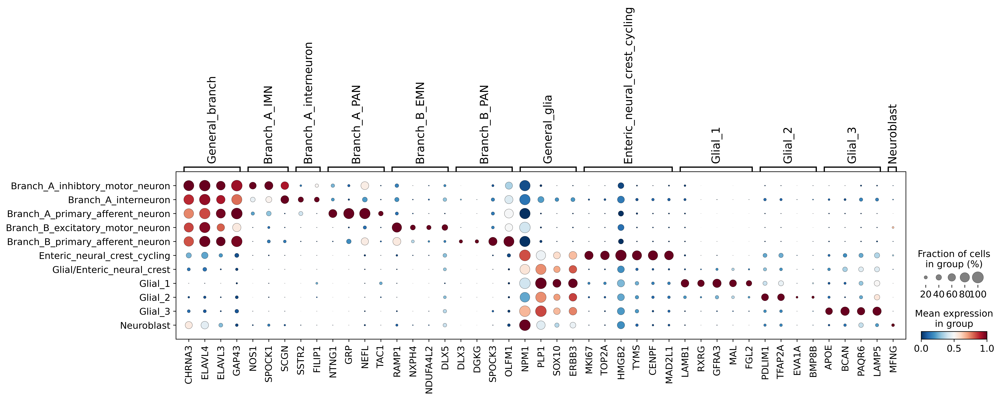

In [18]:
sc.pl.dotplot(adata_nodoublets, var_names=marker_genes_dict, groupby='annot_v3', color_map='RdBu_r', standard_scale='var',save='neural_markers.pdf')

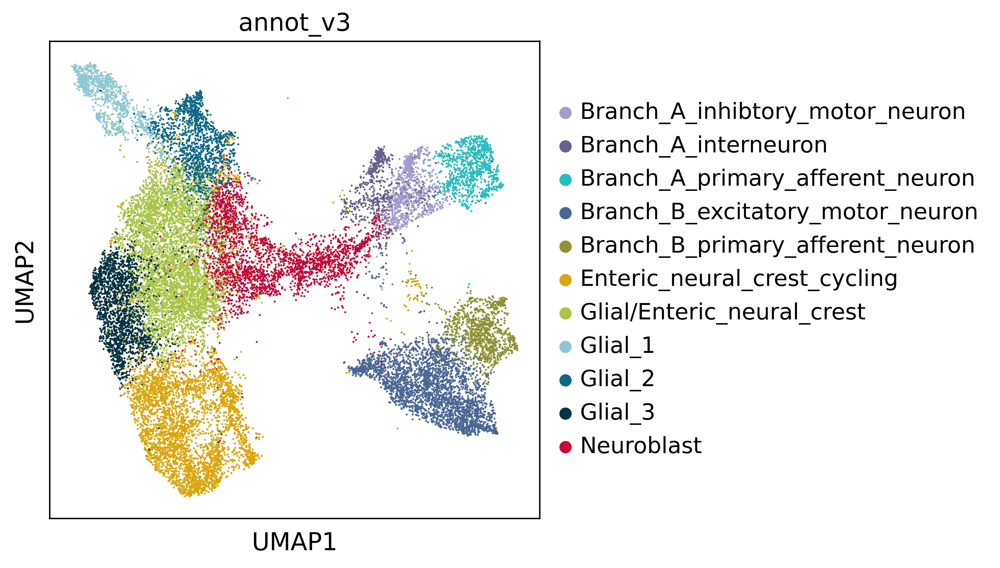

In [21]:
sc.pl.umap(adata_nodoublets,color='annot_v3',palette={'Branch_A_inhibtory_motor_neuron': '#a39bcb',
  'Branch_A_interneuron': '#67608a',
  'Branch_A_primary_afferent_neuron': '#27bdbf',
  'Branch_B_excitatory_motor_neuron': '#496695',
  'Branch_B_primary_afferent_neuron': '#909134',
                                           'Enteric_neural_crest_cycling': '#DBA507',
                                             'Glial/Enteric_neural_crest': '#a8c545',
                                           'Glial_1': '#8EC7D2',
  'Glial_2': '#0D6986',
  'Glial_3': '#053240',
                                           'Neuroblast': '#c50637',


                                       },save='neural_annot.png')

<AxesSubplot: title={'center': 'annot_v3'}, xlabel='UMAP1', ylabel='UMAP2'>

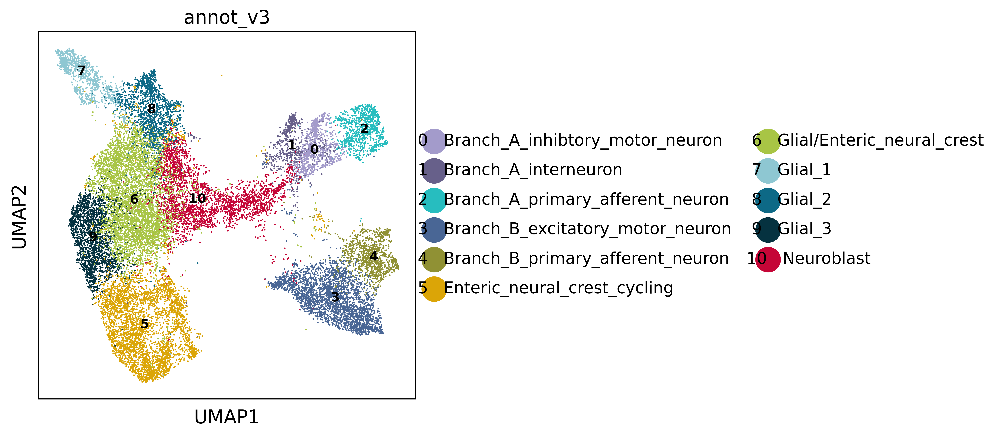

In [22]:
import sctk as sk
sk.plot_embedding(
    adata_nodoublets,
    basis="umap",
    groupby="annot_v3",
    figsize=(5, 5),
    save='figures/neural_annot.png')